### REFERENCE: [First Principles of Computer Vision: Image Stitching Playlist](https://www.youtube.com/playlist?list=PL2zRqk16wsdp8KbDfHKvPYNGF2L-zQASc)

In [1]:
import glob
import cv2
import os
import numpy as np
import matplotlib.pyplot as plt
from tqdm import tqdm
from scipy.ndimage import distance_transform_edt

### Helper Functions

In [2]:
def detect_sift_features(img):

    """Reference: CV2 Sift Features: https://docs.opencv.org/4.x/da/df5/tutorial_py_sift_intro.html"""

    gray= cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    sift = cv2.SIFT_create()    
    kp, des = sift.detectAndCompute(gray,None)
    return (kp, des)
    
def plot_image(img, figsize = None, gray=False):
    if figsize != None:
        plt.figure(figsize=figsize)
    else:
        plt.figure()
    if gray:
        plt.imshow(img, cmap='gray')
    else:
        plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    # plt.axis('off')
    # plt.show()

### Main

#### The issue with Homography Estimation - Non-overlapping images
![issue_homography](../../Images/issue_homography.png)

As visible in the figure above (WLOG, let `Img2` be the reference image), the overlapping pairs of images are:
- (`Img1`, `Img2`)
- (`Img2`, `Img3`)
- (`Img3`, `Img4`)

**Issue**: Homogrpahy estimation fails when finding a Homography Matrix $H_{24}$ as there is no overlapping region to reliably match features.

**Solution**: Estimate Homography Matrices for each pair of overlapping images. Since the Homography Matrices are *closed under composition*, one can estimate Homography Matrix for pairs of non-overlapping images. For example, $H_{23}$ and $H_{34}$ can be estimated because they are derived from pairs of overlapping images. Then,
$$H_{24} = H_{23}\times H_{34}$$

In [363]:
path = '../../Images/I2'
all_images = sorted(glob.glob(path+os.sep+'*'))
print('Found {} Images for stitching'.format(len(all_images)))

Found 5 Images for stitching


Query $\rightarrow$ Image1 (reference image)<br>
Train $\rightarrow$ Image2 (train image)

In [427]:
# def make_panaroma_for_images_in(self, path):

"""
Resources:
1) Feature Detection: https://docs.opencv.org/4.x/da/df5/tutorial_py_sift_intro.html
2) Feature Matching: https://docs.opencv.org/3.4/dc/dc3/tutorial_py_matcher.html
"""
query_image_idx = 1
train_image_idx = 2

# Feature detection
images_with_sift = []
for i in range(len(all_images)):
    img = cv2.imread(all_images[i])
    images_with_sift.append(detect_sift_features(img))

# Feature Matching
bf = cv2.BFMatcher()
matches = bf.knnMatch(images_with_sift[query_image_idx][1], images_with_sift[train_image_idx][1], k=2)
# Ratio Test
good = []
for m,n in matches:
    if m.distance < 0.75*n.distance:
        good.append([m])

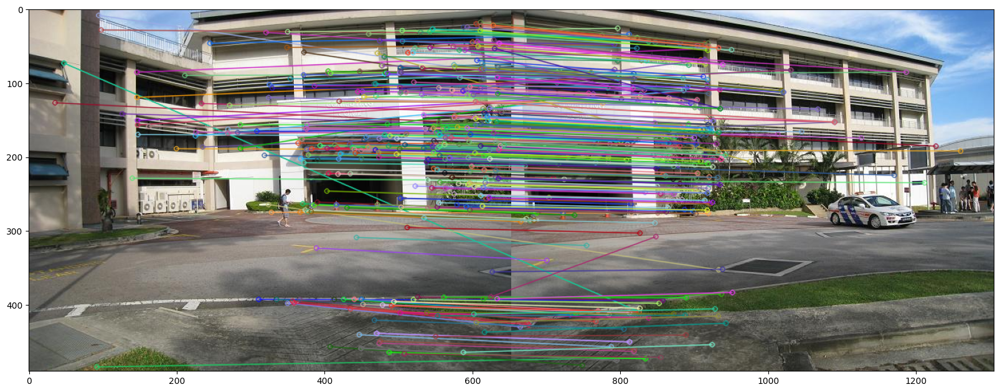

In [428]:
img3 = cv2.drawMatchesKnn(cv2.imread(all_images[query_image_idx]),images_with_sift[query_image_idx][0],cv2.imread(all_images[train_image_idx]),images_with_sift[train_image_idx][0],good,None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
plot_image(img3, figsize=(20,10))

Extracting Coords of Good Features

In [429]:
queries = []
train = []

for i in range(len(good)):
    queries.append(good[i][0].queryIdx)
    train.append(good[i][0].trainIdx)

In [458]:
len(queries), len(train)

(339, 339)

In [430]:
query_coords = []
train_coords = []

for i in range(len(good)):
    query_coords.append(images_with_sift[query_image_idx][0][queries[i]].pt)
    train_coords.append(images_with_sift[train_image_idx][0][train[i]].pt)

In [431]:
len(query_coords), len(train_coords), img3.shape

(339, 339, (490, 1306, 3))

In [432]:
# plot_image(img3, figsize = (20, 10))
# for i in range(len(query_coords)):
#     if i > 800 and i < 810:
#         plt.plot([query_coords[i][0], img3.shape[1]//2 + train_coords[i][0]], [query_coords[i][1], train_coords[i][1]], color='lightgreen')
#     plt.scatter(query_coords[i][0], query_coords[i][1], color='red', s =10)
#     plt.scatter(img3.shape[1]//2 + train_coords[i][0], train_coords[i][1], color='blue', s =10)
# plt.xlim(0, img3.shape[1])
# plt.ylim(img3.shape[0], 0)
# plt.show()

#### Homography Matrix Estimation - RANSAC

In [3]:
def RANSAC(query_coords, train_coords, epsilon = 5.0, s = 4, N = 1000):
    """
    RANSAC Algorithm to find the best homography matrix
    """
    best_inliers = []
    best_transform = None
    for i in tqdm(range(N)):
        # Randomly select s matches
        random_indices = np.random.choice(len(query_coords), s, replace=False)
        q = np.array([query_coords[i] for i in random_indices])
        t = np.array([train_coords[i] for i in random_indices])

        # Estimate homography matrix
        A = np.zeros((2*s, 9))
        for i in range(s):
            A[2*i] = np.array([-q[i][0], -q[i][1], -1, 0, 0, 0, q[i][0]*t[i][0], q[i][1]*t[i][0], t[i][0]])
            A[2*i+1] = np.array([0, 0, 0, -q[i][0], -q[i][1], -1, q[i][0]*t[i][1], q[i][1]*t[i][1], t[i][1]])
        
        U, S, V = np.linalg.svd(A)
        H = V[-1].reshape(3,3)

        # Calculate error
        inliers = []
        error = 0
        for i in range(len(query_coords)):
            q = np.array([query_coords[i][0], query_coords[i][1], 1])
            t = np.array([train_coords[i][0], train_coords[i][1], 1])
            t_ = np.dot(H, q)
            t_ = t_/t_[-1]
            error += np.linalg.norm(t-t_)
            if (np.linalg.norm(t-t_)) < epsilon:
                inliers.append(i)
        
        if len(inliers) > len(best_inliers):
            best_inliers = inliers
            best_transform = H
    
    A = np.zeros((2*len(best_inliers), 9))
    for i, inlier  in enumerate(best_inliers):
        A[2*i] = np.array([-query_coords[inlier][0], -query_coords[inlier][1], -1, 0, 0, 0, query_coords[inlier][0]*train_coords[inlier][0], query_coords[inlier][1]*train_coords[inlier][0], train_coords[inlier][0]])
        A[2*i+1] = np.array([0, 0, 0, -query_coords[inlier][0], -query_coords[inlier][1], -1, query_coords[inlier][0]*train_coords[inlier][1], query_coords[inlier][1]*train_coords[inlier][1], train_coords[inlier][1]])

    U, S, V = np.linalg.svd(A)
    best_transform = V[-1].reshape(3,3)
                                   
    return best_transform, best_inliers

In [434]:
H, inliers = RANSAC(query_coords, train_coords, epsilon = 5.0, s = 4, N = 1000)

100%|██████████| 1000/1000 [00:04<00:00, 234.44it/s]


In [435]:
H, len(inliers)

(array([[ 2.76356963e-03, -5.56996161e-05, -9.77374785e-01],
        [ 4.70745333e-04,  2.43977244e-03, -2.11476744e-01],
        [ 1.90869700e-06, -5.06798330e-08,  1.51747152e-03]]),
 216)

Plotting the inliers

In [436]:
# plot_image(img3, figsize = (20, 10))
# for i in range(len(query_coords)):
#     if i in inliers[1300:1320]:
#         plt.plot([query_coords[i][0], img3.shape[1]//2 + train_coords[i][0]], [query_coords[i][1], train_coords[i][1]], color='lightgreen')
#         plt.scatter(query_coords[i][0], query_coords[i][1], color='red', s =10)
#         plt.scatter(img3.shape[1]//2 + train_coords[i][0], train_coords[i][1], color='blue', s =10)

#### Warping and Coordinate Transform

In [437]:
H_inv = np.linalg.inv(H)
corners = np.array([[0,0,1], [0,img3.shape[0],1], [img3.shape[1]//2, img3.shape[0],1], [img3.shape[1]//2, 0, 1]])
corners_ = np.dot(H_inv, corners.T).T
corners_ = corners_/corners_[:,2].reshape(-1,1)
corners_

array([[ 3.54034122e+02,  1.83692677e+01,  1.00000000e+00],
       [ 3.62852328e+02,  4.55889816e+02,  1.00000000e+00],
       [ 1.30676474e+03,  6.33793579e+02,  1.00000000e+00],
       [ 1.29489028e+03, -1.63165551e+02,  1.00000000e+00]])

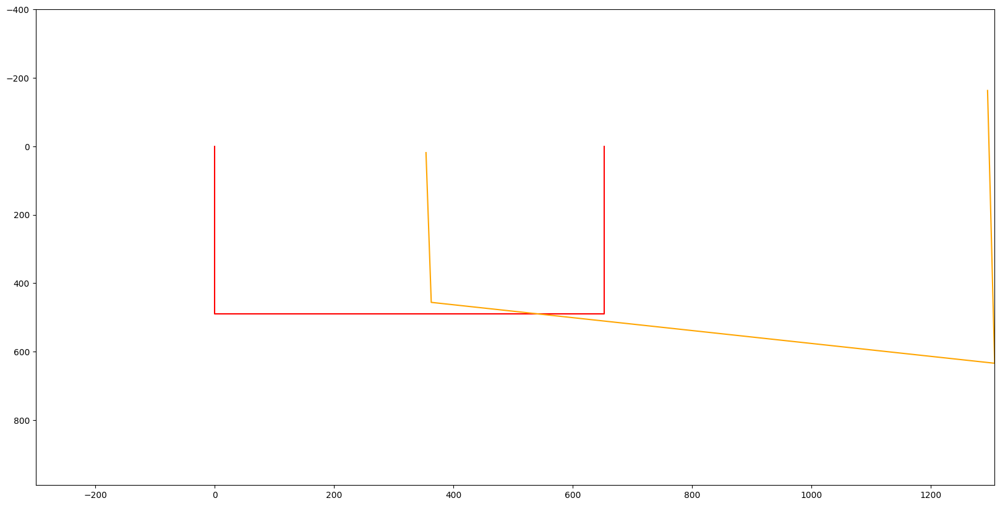

In [438]:
plt.figure(figsize=(20,10))
plt.plot(corners[:,0], corners[:,1], color='red')
plt.plot(corners_[:,0], corners_[:,1], color='orange')
plt.xlim(-300, img3.shape[1])
plt.ylim(img3.shape[0]+500, -400)
plt.show()

Get Bounding Box/Canvas Size

![canvas](../../Images/canvas.png)

In [439]:
all_corners = np.concatenate([corners[:, :2], corners_[:, :2]], axis=0)
min_x = int(np.min(all_corners[:,0]))
max_x = int(np.max(all_corners[:,0]))
min_y = int(np.min(all_corners[:,1]))
max_y = int(np.max(all_corners[:,1]))

In [440]:
min_x, max_x, min_y, max_y

(0, 1306, -163, 633)

![coord_transform](../../Images/coord_transform.png)

In [441]:
def coordinate_transform(img, H):
    H_inv = np.linalg.inv(H)
    X, Y = np.meshgrid(np.arange(img.shape[1]), np.arange(img.shape[0]))
    pixels = np.array([X.flatten(), Y.flatten(), np.ones(X.size)]).reshape(3, X.shape[0], X.shape[1])
    new_pixels = np.tensordot(H_inv, pixels, axes=(1, 0))
    new_pixels = new_pixels/new_pixels[-1]
    return new_pixels
    
new_pixels = coordinate_transform(cv2.imread(all_images[train_image_idx]), H)

Warping Image

![bilinear_interp](../../Images/warp_bil_interp.png)

In [442]:
def bilinear_interpolation(img, x, y, p):
    i, j = p[0], p[1]
    h, w, c = img.shape
    if i < x + 0.5 and j < y + 0.5:
        x1 = x - 1
        y1 = y
        x2 = x
        y2 = y - 1
    elif i < x + 0.5 and j >= y + 0.5:
        x1 = x - 1
        y1 = y + 1
        x2 = x
        y2 = y
    elif i >= x + 0.5 and j < y + 0.5:
        x1 = x
        y1 = y
        x2 = x + 1
        y2 = y - 1
    else:
        x1 = x
        y1 = y + 1
        x2 = x + 1
        y2 = y
    
    Ix1y1 = img[y1, x1, :] if x1 >= 0 and y1 >= 0 and x1 < img.shape[1] and y1 < img.shape[0] else 0
    Ix2y1 = img[y1, x2, :] if x2 >= 0 and y1 >= 0 and x2 < img.shape[1] and y1 < img.shape[0] else 0
    Ix1y2 = img[y2, x1, :] if x1 >= 0 and y2 >= 0 and x1 < img.shape[1] and y2 < img.shape[0] else 0
    Ix2y2 = img[y2, x2, :] if x2 >= 0 and y2 >= 0 and x2 < img.shape[1] and y2 < img.shape[0] else 0

    I = np.zeres(c)
    for k in range(c):
        I[k] =  1/(x2-x1)/(y2-y1) * np.array([x2-i, i-x1]).dot(np.array([[Ix1y1[k], Ix2y1[k]], [Ix1y2[k], Ix2y2[k]]]).dot(np.array([y2-j, j-y1])))
    return I


def warp(img, H, dsize):
    """
    Reference: https://en.wikipedia.org/wiki/Bilinear_interpolation
    """

    new_img = np.zeros((dsize[1], dsize[0], 3), dtype=np.uint8)

    for i in range(dsize[1]):
        for j in range(dsize[0]):
            p = np.array([i, j, 1])
            p_ = np.dot(H, p)
            p_ = p_/p_[-1]
            x, y = int(p_[0]), int(p_[1])
            if x >= 0 and x < img.shape[1] and y >= 0 and y < img.shape[0]:
                # Bilinear Interpolation
                new_img[j, i, :] = bilinear_interpolation(img, x, y, p_)
    return new_img

In [443]:
translation = np.array([[1, 0, -min_x], [0, 1, -min_y], [0, 0, 1]])
warped = cv2.warpPerspective(cv2.imread(all_images[train_image_idx]), translation @ H_inv, (max_x-min_x, max_y-min_y))

In [444]:
warped.shape

(796, 1306, 3)

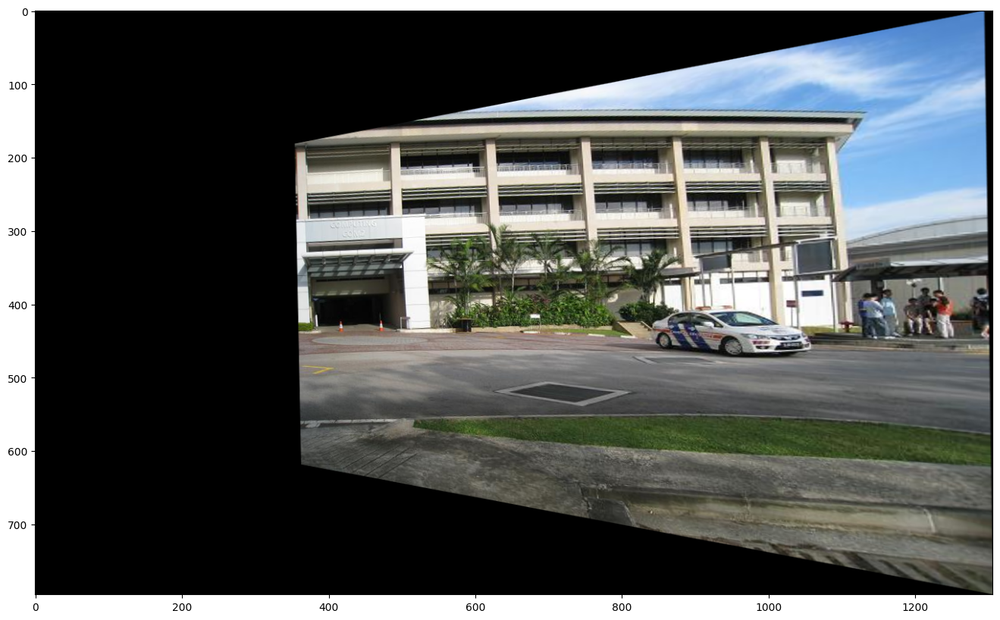

In [445]:
plot_image(warped, figsize=(20,10))

In [446]:
translation = translation.astype(np.float32)
original = cv2.warpPerspective(cv2.imread(all_images[query_image_idx]), translation, (max_x-min_x, max_y-min_y))

In [447]:
original.shape

(796, 1306, 3)

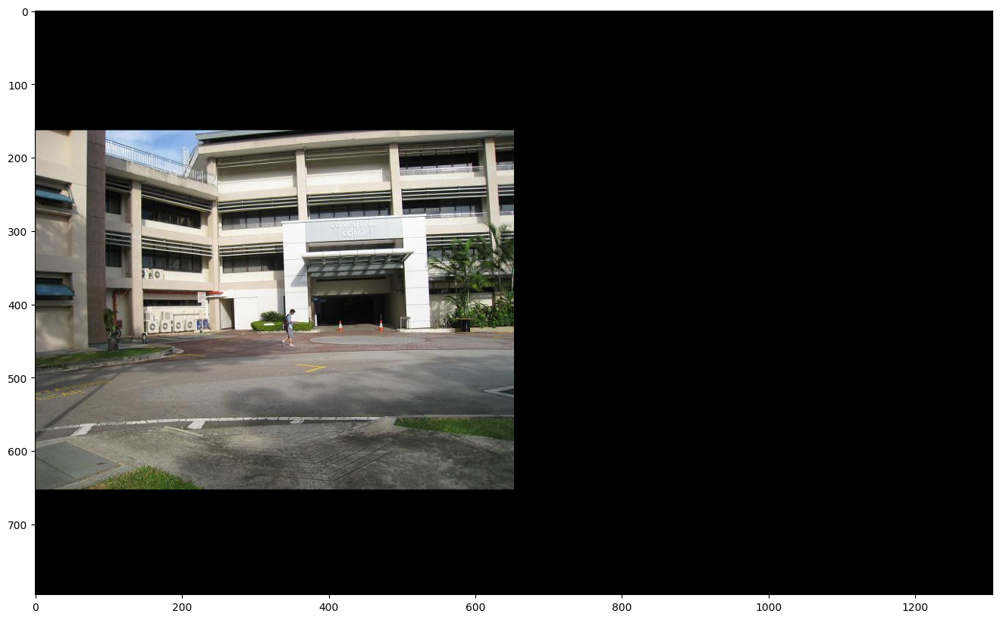

In [448]:
plot_image(original, figsize=(20,10))

In [449]:
pre_final = original.copy()
pre_final[warped>0] = warped[warped>0]

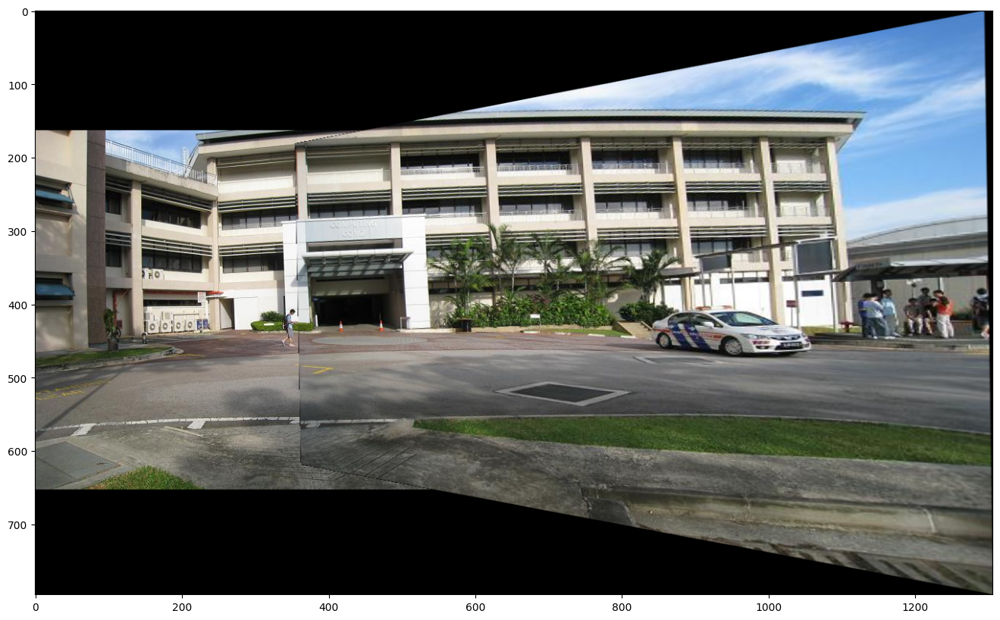

In [450]:
plot_image(pre_final, figsize=(20,10))

#### Blending

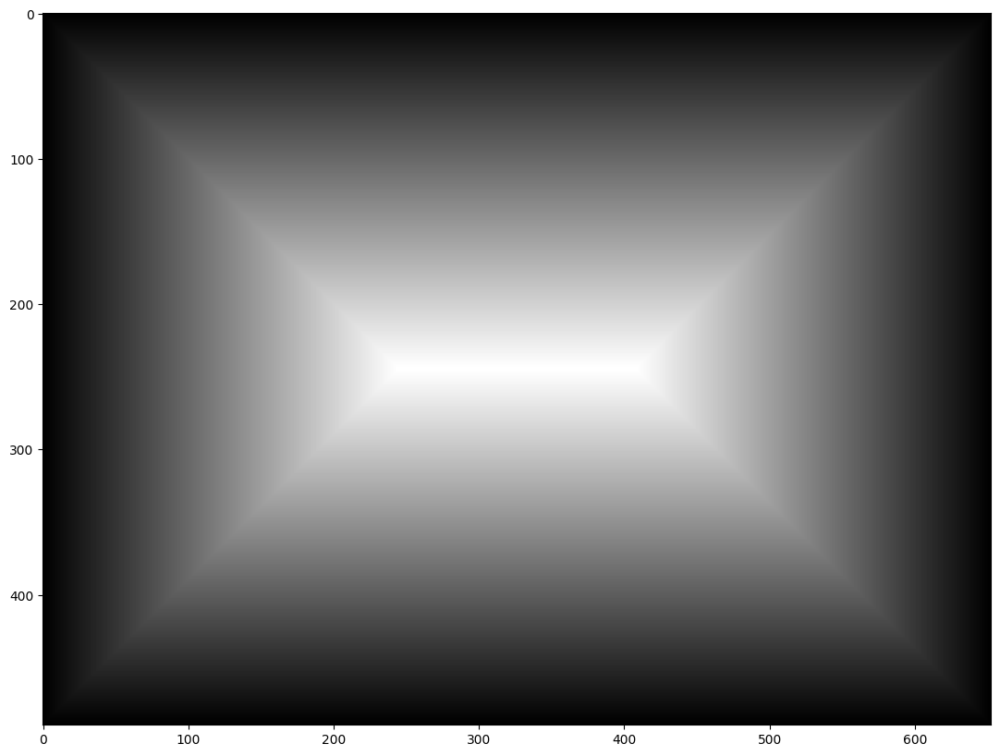

In [451]:
"""
References: 
https://docs.scipy.org/doc/scipy/reference/generated/scipy.ndimage.distance_transform_edt.html
https://github.com/CorentinBrtx/image-stitching/tree/main
"""
h, w, c = cv2.imread(all_images[query_image_idx]).shape
base = np.zeros((h, w))
base[1:h-1, 1:w-1] = 1
mask = distance_transform_edt(base)
plot_image(mask, figsize=(20,10), gray=True)

In [4]:
def single_weights_array(size: int) -> np.ndarray:
    """
    Create a 1D weights array.

    Args:
        size: Size of the array

    Returns:
        weights: 1D weights array
    """
    if size % 2 == 1:
        return np.concatenate(
            [np.linspace(0, 1, (size + 1) // 2), np.linspace(1, 0, (size + 1) // 2)[1:]]
        )
    else:
        return np.concatenate([np.linspace(0, 1, size // 2), np.linspace(1, 0, size // 2)])


def single_weights_matrix(shape: tuple[int]) -> np.ndarray:
    """
    Create a 2D weights matrix.

    Args:
        shape: Shape of the matrix

    Returns:
        weights: 2D weights matrix
    """
    return (
        single_weights_array(shape[0])[:, np.newaxis]
        @ single_weights_array(shape[1])[:, np.newaxis].T
    )

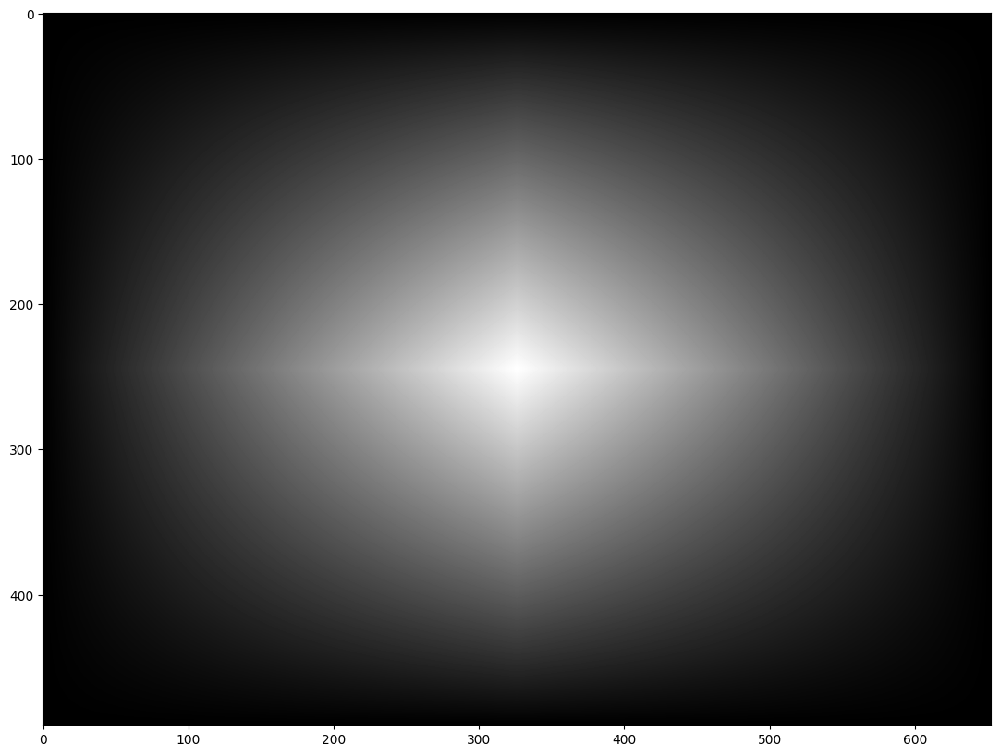

In [453]:
mask = single_weights_matrix(mask.shape)
plot_image(mask, figsize=(20,10), gray=True)

In [454]:
mask1 = cv2.warpPerspective(mask, translation, (max_x-min_x, max_y-min_y))
mask2 = cv2.warpPerspective(mask, translation @ H_inv, (max_x-min_x, max_y-min_y))

# plot_image(mask1, figsize=(20,10), gray=True)
# plot_image(mask2, figsize=(20,10), gray=True)

mask1 = mask1/mask1.max()
mask2 = mask2/mask2.max()

mask1 = np.array([mask1, mask1, mask1]).transpose(1,2,0)
mask2 = np.array([mask2, mask2, mask2]).transpose(1,2,0)

In [455]:
normalized_mask = np.divide(mask1, mask1+mask2, where=(mask1+mask2)!=0)
normalized_mask = normalized_mask/normalized_mask.max()

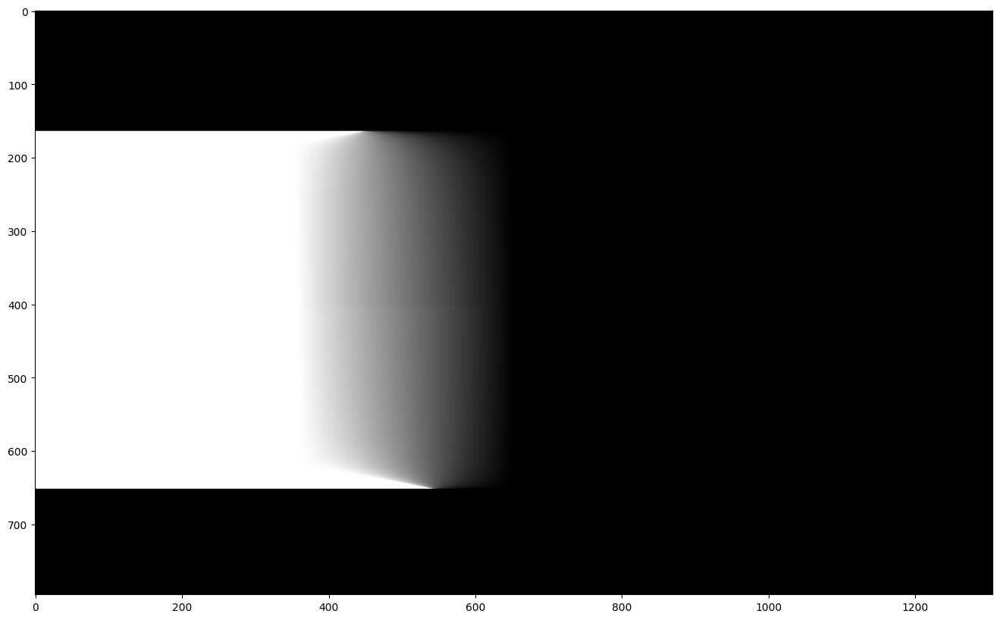

In [456]:
plot_image(normalized_mask, figsize=(20,10), gray=True)

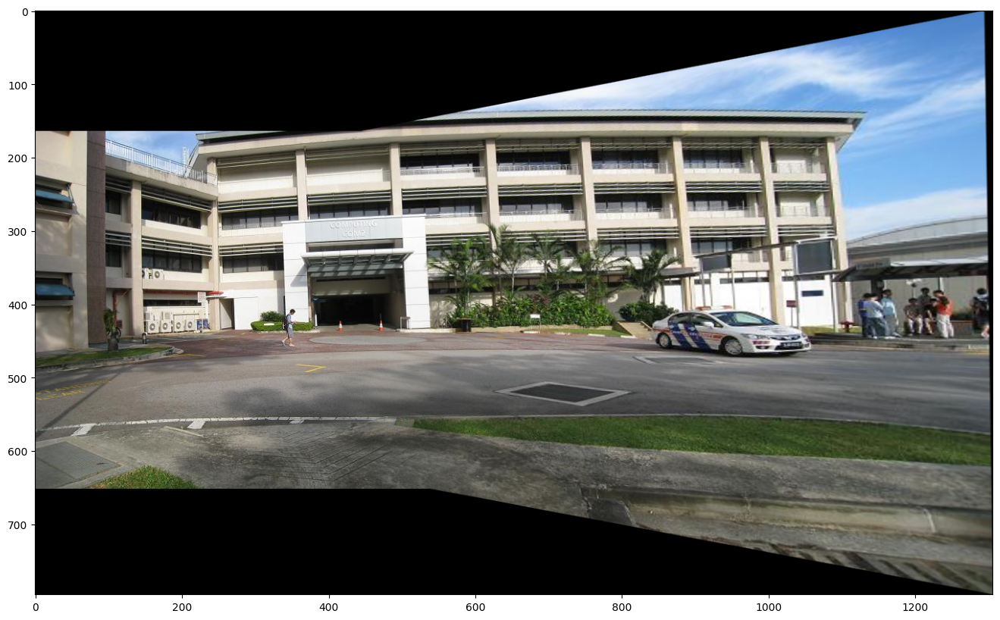

In [457]:
blended = normalized_mask * original + (1-normalized_mask) * warped
blended = blended.astype(np.uint8)
plot_image(blended, figsize=(20,10))

# SEMI-GOD FUNCTION

In [1]:
import glob
import cv2
import os
import numpy as np
import matplotlib.pyplot as plt
from tqdm import tqdm

In [2]:
def detect_sift_features(img):

    """Reference: CV2 Sift Features: https://docs.opencv.org/4.x/da/df5/tutorial_py_sift_intro.html"""

    gray= cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    sift = cv2.SIFT_create()    
    kp, des = sift.detectAndCompute(gray,None)
    return (kp, des)
    
def plot_image(img, figsize = None, gray=False):
    if figsize != None:
        plt.figure(figsize=figsize)
    else:
        plt.figure()
    if gray:
        plt.imshow(img, cmap='gray')
    else:
        plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    # plt.axis('off')
    plt.show()

In [3]:
def RANSAC(query_coords, train_coords, epsilon = 5.0, s = 4, N = 1000):
    """
    RANSAC Algorithm to find the best homography matrix
    """
    best_inliers = []
    best_transform = None
    for i in tqdm(range(N)):
        # Randomly select s matches
        random_indices = np.random.choice(len(query_coords), s, replace=False)
        q = np.array([query_coords[i] for i in random_indices])
        t = np.array([train_coords[i] for i in random_indices])

        # Estimate homography matrix
        A = np.zeros((2*s, 9))
        for i in range(s):
            A[2*i] = np.array([-q[i][0], -q[i][1], -1, 0, 0, 0, q[i][0]*t[i][0], q[i][1]*t[i][0], t[i][0]])
            A[2*i+1] = np.array([0, 0, 0, -q[i][0], -q[i][1], -1, q[i][0]*t[i][1], q[i][1]*t[i][1], t[i][1]])
        
        U, S, V = np.linalg.svd(A)
        H = V[-1].reshape(3,3)

        # Calculate error
        inliers = []
        error = 0
        for i in range(len(query_coords)):
            q = np.array([query_coords[i][0], query_coords[i][1], 1])
            t = np.array([train_coords[i][0], train_coords[i][1], 1])
            t_ = np.dot(H, q)
            t_ = t_/t_[-1]
            error += np.linalg.norm(t-t_)
            if (np.linalg.norm(t-t_)) < epsilon:
                inliers.append(i)
        
        if len(inliers) > len(best_inliers):
            best_inliers = inliers
            best_transform = H
    
    A = np.zeros((2*len(best_inliers), 9))
    for i, inlier  in enumerate(best_inliers):
        A[2*i] = np.array([-query_coords[inlier][0], -query_coords[inlier][1], -1, 0, 0, 0, query_coords[inlier][0]*train_coords[inlier][0], query_coords[inlier][1]*train_coords[inlier][0], train_coords[inlier][0]])
        A[2*i+1] = np.array([0, 0, 0, -query_coords[inlier][0], -query_coords[inlier][1], -1, query_coords[inlier][0]*train_coords[inlier][1], query_coords[inlier][1]*train_coords[inlier][1], train_coords[inlier][1]])

    U, S, V = np.linalg.svd(A)
    best_transform = V[-1].reshape(3,3)
                                   
    return best_transform, best_inliers

In [4]:
def single_weights_array(size: int) -> np.ndarray:
    if size % 2 == 1:
        return np.concatenate(
            [np.linspace(0, 1, (size + 1) // 2), np.linspace(1, 0, (size + 1) // 2)[1:]]
        )
    else:
        return np.concatenate([np.linspace(0, 1, size // 2), np.linspace(1, 0, size // 2)])


def single_weights_matrix(shape: tuple[int]) -> np.ndarray:
    return (
        single_weights_array(shape[0])[:, np.newaxis]
        @ single_weights_array(shape[1])[:, np.newaxis].T
    )

In [5]:
def stitch(path, a, b, verbose = False):
    all_images = sorted(glob.glob(path+os.sep+'*'))
    if verbose:
        print('Found {} Images for stitching'.format(len(all_images)))

    query_image_idx = a
    train_image_idx = b

    # Feature detection
    images_with_sift = []
    for i in range(len(all_images)):
        img = cv2.imread(all_images[i])
        images_with_sift.append(detect_sift_features(img))
    if verbose:
        print('Feature Detection Done')

    # Feature Matching
    bf = cv2.BFMatcher()
    matches = bf.knnMatch(images_with_sift[query_image_idx][1], images_with_sift[train_image_idx][1], k=2)
    # Ratio Test
    good = []
    for m,n in matches:
        if m.distance < 0.75*n.distance:
            good.append([m])
    if verbose:
        print('Feature Matching Done')

    # Feature Coodinates Extraction 
    query_coords = []
    train_coords = []
    for i in range(len(good)):
        query_coords.append(images_with_sift[query_image_idx][0][good[i][0].queryIdx].pt)
        train_coords.append(images_with_sift[train_image_idx][0][good[i][0].trainIdx].pt)
    if verbose:
        print('Feature Coordinates Extraction Done')

    # Homography Estimation
    H, inliers = RANSAC(query_coords, train_coords, epsilon = 5.0, s = 4, N = 1000)
    if verbose:
        print('Homography Estimation Done')

    # Canvas Size Calculation
    H_inv = np.linalg.inv(H)
    corners = np.array([[0,0,1], [0,img.shape[0],1], [img.shape[1], img.shape[0],1], [img.shape[1], 0, 1]])
    corners_ = np.dot(H_inv, corners.T).T
    corners_ = corners_/corners_[:,2].reshape(-1,1)
    corners_

    all_corners = np.concatenate([corners[:, :2], corners_[:, :2]], axis=0)
    min_x = int(np.min(all_corners[:,0]))
    max_x = int(np.max(all_corners[:,0]))
    min_y = int(np.min(all_corners[:,1]))
    max_y = int(np.max(all_corners[:,1]))
    if verbose:
        print('Canvas Size Calculation Done')

    # Image Warping
    translation = np.array([[1, 0, -min_x], [0, 1, -min_y], [0, 0, 1]])
    train_warped = cv2.warpPerspective(cv2.imread(all_images[train_image_idx]), translation @ H_inv, (max_x-min_x, max_y-min_y))

    translation = translation.astype(np.float32)
    query_warped = cv2.warpPerspective(cv2.imread(all_images[query_image_idx]), translation, (max_x-min_x, max_y-min_y))
    if verbose:
        print('Image Warping Done')

    # Blending
    mask = single_weights_matrix(img.shape[:2])

    mask1 = cv2.warpPerspective(mask, translation, (max_x-min_x, max_y-min_y))
    mask2 = cv2.warpPerspective(mask, translation @ H_inv, (max_x-min_x, max_y-min_y))

    mask1 = mask1/mask1.max()
    mask2 = mask2/mask2.max()

    normalized_mask = np.divide(mask1, mask1+mask2, where=(mask1+mask2)!=0)
    normalized_mask = normalized_mask/normalized_mask.max()

    normalized_mask = np.array([normalized_mask, normalized_mask, normalized_mask]).transpose(1,2,0)

    blended = normalized_mask * query_warped + (1-normalized_mask) * train_warped
    blended = blended.astype(np.uint8)

    if verbose:
        print('Blending Done')
    return  blended, H, translation, (mask1 + mask2)/(mask1 + mask2).max()

In [47]:
path = '../../Images/I5'
blended_images = []
H_matrices = []
translation_matrices = []
weights = []
for i in range(len(os.listdir(path))-1):
    stitched_img, H, translation, weight = stitch(path, i, i+1, verbose = False)
    blended_images.append(stitched_img)
    H_matrices.append(H)
    translation_matrices.append(translation)
    weights.append(weight)

100%|██████████| 1000/1000 [01:32<00:00, 10.76it/s]


In [81]:
all_images = sorted(glob.glob(path+os.sep+'*'))
images = []
for i in range(len(all_images)):
    img = cv2.imread(all_images[i])
    images.append(img)

In [192]:
query_image_idx = 2
train_image_idx = 3

In [136]:
h3 = H_matrices[query_image_idx]
for i in range(query_image_idx+1, train_image_idx):
    h3 = h3 @ H_matrices[i]
    h3 = h3/h3[-1,-1]
h3

array([[-4.85648378e-03,  2.21356147e-04,  9.99191529e-01],
       [-3.52010005e-04, -4.35395200e-03, -3.94891256e-02],
       [-1.87363508e-06,  5.51062869e-07, -3.76581905e-03]])

In [82]:
h34 = H_matrices[3]
h34 = h34/h34[-1,-1]
h34

array([[ 1.33750001e+00,  2.94197182e-02, -8.38938333e+02],
       [ 9.44651087e-02,  1.23017805e+00, -1.94015089e+02],
       [ 1.64906816e-04,  2.07744994e-05,  1.00000000e+00]])

In [83]:
# Canvas Size Calculation
H_inv34 = np.linalg.inv(h34)
corners = np.array([[0,0,1], [0,img.shape[0],1], [img.shape[1], img.shape[0],1], [img.shape[1], 0, 1]])
corners_ = np.dot( H_inv34, corners.T).T # translation_matrices[2] @
corners_ = corners_/corners_[:,2].reshape(-1,1)
corners_

canvas_shape = img.shape # blended_images[2]
canvas_corners = np.array([[0,0,1], [0,canvas_shape[0],1], [canvas_shape[1], canvas_shape[0],1], [canvas_shape[1], 0, 1]])
all_corners = np.concatenate([canvas_corners[:, :2], corners_[:, :2]], axis=0)
min_x = int(np.min(all_corners[:,0]))
max_x = int(np.max(all_corners[:,0]))
min_y = int(np.min(all_corners[:,1]))
max_y = int(np.max(all_corners[:,1]))

In [84]:
all_corners

array([[   0.        ,    0.        ],
       [   0.        , 1329.        ],
       [2000.        , 1329.        ],
       [2000.        ,    0.        ],
       [ 624.82992912,  109.73245864],
       [ 598.02234017, 1328.47800109],
       [2836.06752991, 1560.54406584],
       [2816.57862258,  -58.57145399]])

In [85]:
min_x, max_x, min_y, max_y

(0, 2836, -58, 1560)

In [86]:
# Image Warping
translation = np.array([[1, 0, -min_x], [0, 1, -min_y], [0, 0, 1]])
train_warped = cv2.warpPerspective(cv2.imread(all_images[1]), translation_matrices[2] @ translation @ H_inv, (max_x-min_x, max_y-min_y))

translation = translation.astype(np.float32)
query_warped = cv2.warpPerspective(blended_images[2], translation, (max_x-min_x, max_y-min_y))

# Blending
mask = single_weights_matrix(img.shape[:2])

mask1 = cv2.warpPerspective(weights[2], translation, (max_x-min_x, max_y-min_y))
mask2 = cv2.warpPerspective(mask,  translation_matrices[2]  @  translation @ H_inv, (max_x-min_x, max_y-min_y))

mask1 = mask1/mask1.max()
mask2 = mask2/mask2.max()

normalized_mask = np.divide(mask1, mask1+mask2, where=(mask1+mask2)!=0)
normalized_mask = normalized_mask/normalized_mask.max()

normalized_mask = np.array([normalized_mask, normalized_mask, normalized_mask]).transpose(1,2,0)

blended = normalized_mask * query_warped + (1-normalized_mask) * train_warped
blended = blended.astype(np.uint8)


NameError: name 'H_inv' is not defined

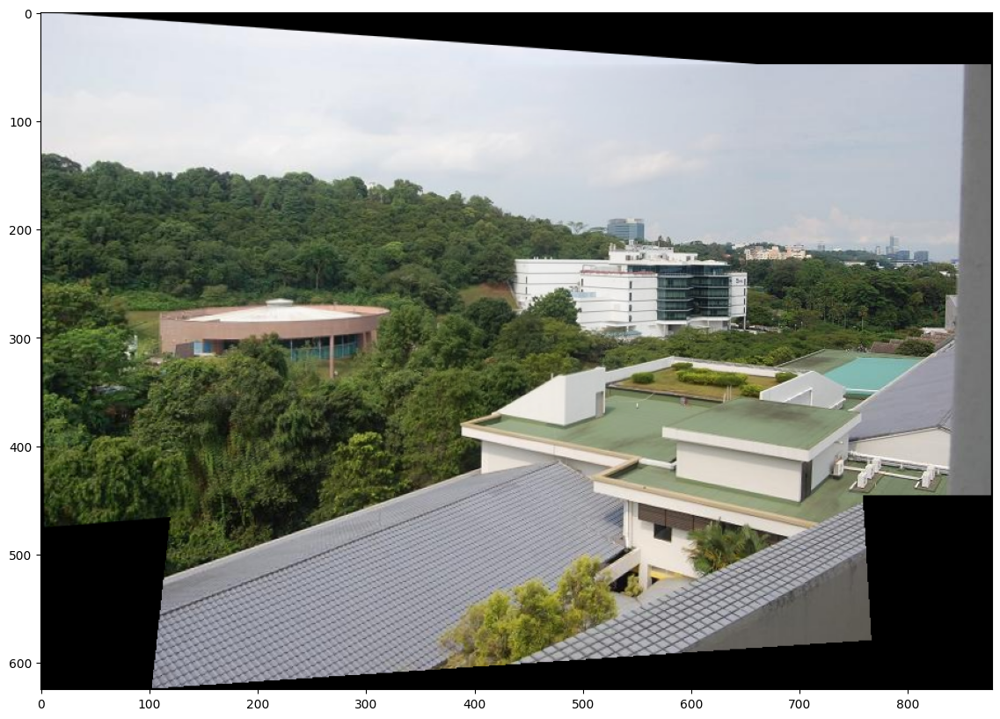

In [217]:
plot_image(blended, figsize=(20,10))

In [87]:
translation34 = np.array([[1, 0, -min_x], [0, 1, -min_y], [0, 0, 1]])
train_warped = cv2.warpPerspective(cv2.imread(all_images[4]), translation34 @ H_inv34, (max_x-min_x, max_y-min_y))

translation34 = translation34.astype(np.float32)
query_warped = cv2.warpPerspective(cv2.imread(all_images[3]), translation34, (max_x-min_x, max_y-min_y))


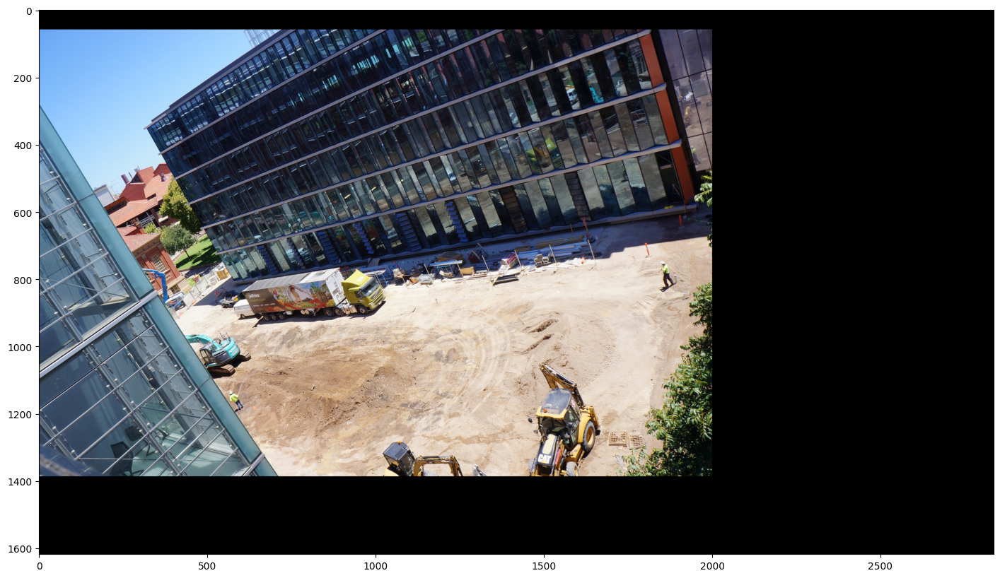

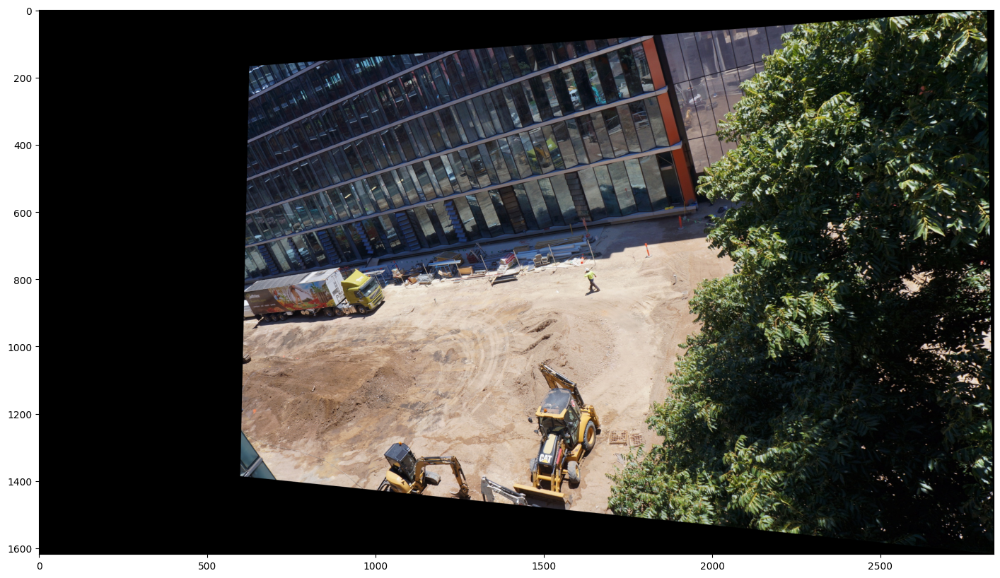

In [88]:
plot_image(query_warped, figsize=(20,10))
plot_image(train_warped, figsize=(20,10))

In [89]:
# Blending
mask = single_weights_matrix(img.shape[:2])

mask1 = cv2.warpPerspective(mask, translation34, (max_x-min_x, max_y-min_y))
mask2 = cv2.warpPerspective(mask,  translation34 @ H_inv34, (max_x-min_x, max_y-min_y))

mask1 = mask1/mask1.max()
mask2 = mask2/mask2.max()

normalized_mask = np.divide(mask1, mask1+mask2, where=(mask1+mask2)!=0)
normalized_mask = normalized_mask/normalized_mask.max()

normalized_mask = np.array([normalized_mask, normalized_mask, normalized_mask]).transpose(1,2,0)

blended34 = normalized_mask * query_warped + (1-normalized_mask) * train_warped
blended34 = blended34.astype(np.uint8)
weights34 = (mask1 + mask2)/(mask1 + mask2).max()

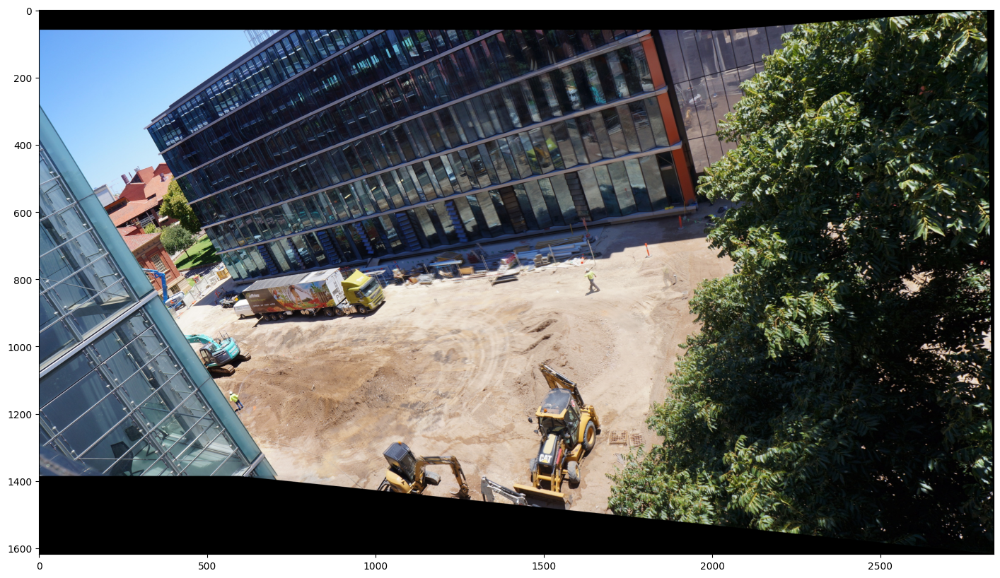

In [90]:
plot_image(blended34, figsize=(20,10))

In [91]:
h23 = H_matrices[2]
h23 = h23/h23[-1,-1]
h23

array([[ 1.24265677e+00,  5.12632813e-02, -5.69619490e+02],
       [ 3.50002588e-02,  1.15578195e+00, -1.23379811e+02],
       [ 1.15898444e-04,  1.87082665e-05,  1.00000000e+00]])

In [92]:
# Canvas Size Calculation
H_inv23 = np.linalg.inv(h23)
corners = np.array([[0,0,1], [0,blended34.shape[0],1], [blended34.shape[1], blended34.shape[0],1], [blended34.shape[1], 0, 1]])
corners_ = np.dot(H_inv23 @ np.linalg.inv(translation34), corners.T).T # translation_matrices[2] @
corners_ = corners_/corners_[:,2].reshape(-1,1)
corners_

canvas_shape = img.shape # blended_images[2]
canvas_corners = np.array([[0,0,1], [0,canvas_shape[0],1], [canvas_shape[1], canvas_shape[0],1], [canvas_shape[1], 0, 1]])
all_corners = np.concatenate([canvas_corners[:, :2], corners_[:, :2]], axis=0)
min_x = int(np.min(all_corners[:,0]))
max_x = int(np.max(all_corners[:,0]))
min_y = int(np.min(all_corners[:,1]))
max_y = int(np.max(all_corners[:,1]))

In [93]:
all_corners

array([[   0.        ,    0.        ],
       [   0.        , 1329.        ],
       [2000.        , 1329.        ],
       [2000.        ,    0.        ],
       [ 456.73656692,   40.04235439],
       [ 394.64064106, 1545.28979194],
       [3730.06708421, 1976.95216114],
       [3726.03518322,  -77.86478431]])

In [94]:
min_x, max_x, min_y, max_y

(0, 3730, -77, 1976)

In [95]:
translation23 = np.array([[1, 0, -min_x], [0, 1, -min_y], [0, 0, 1]])
train_warped = cv2.warpPerspective(blended34, translation23 @ H_inv23 @ np.linalg.inv(translation34), (max_x-min_x, max_y-min_y))

translation23 = translation23.astype(np.float32)
query_warped = cv2.warpPerspective(cv2.imread(all_images[2]), translation23, (max_x-min_x, max_y-min_y))


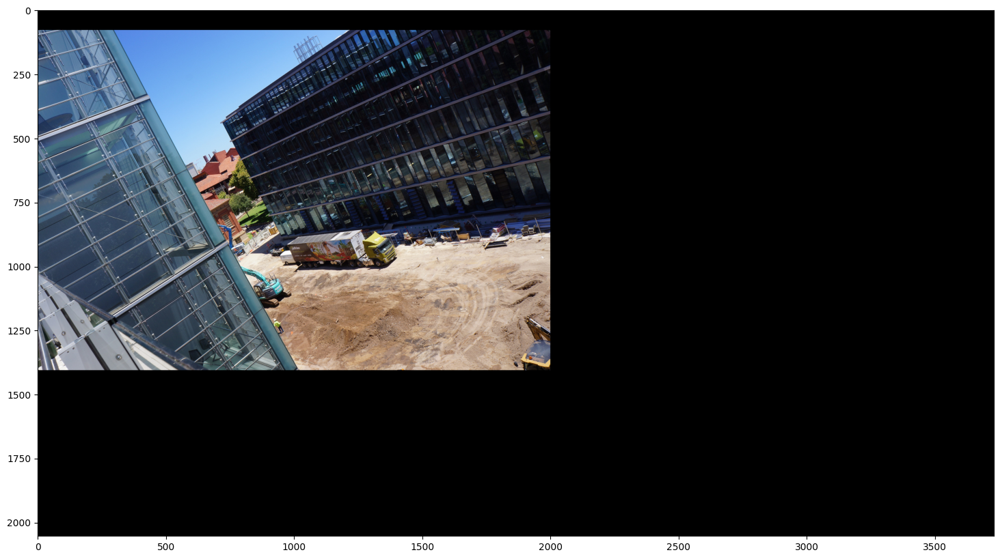

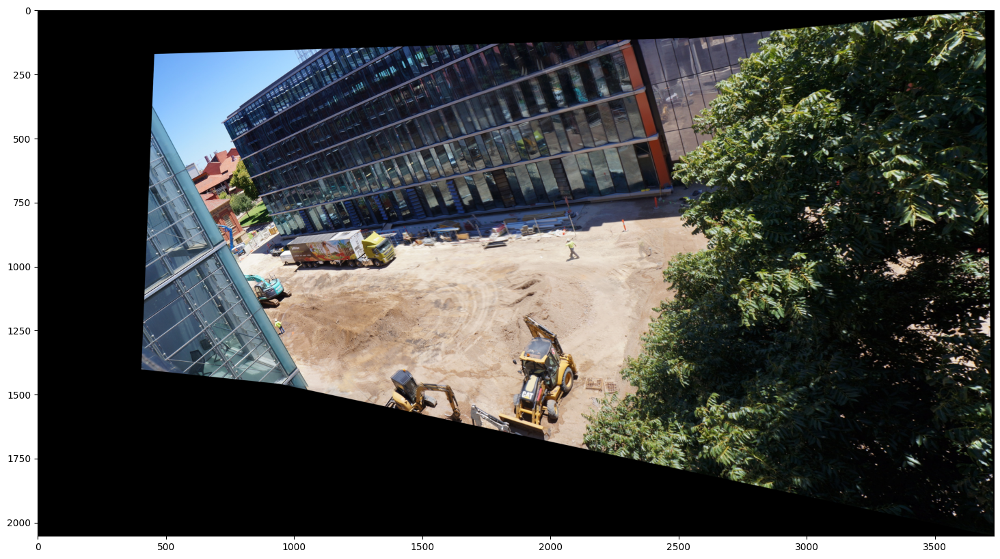

In [96]:
plot_image(query_warped, figsize=(20,10))
plot_image(train_warped, figsize=(20,10))

In [97]:
# Blending
mask = single_weights_matrix(img.shape[:2])

mask1 = cv2.warpPerspective(mask, translation23, (max_x-min_x, max_y-min_y))
mask2 = cv2.warpPerspective(weights34,  translation23 @ H_inv23 @ np.linalg.inv(translation34), (max_x-min_x, max_y-min_y))

mask1 = mask1/mask1.max()
mask2 = mask2/mask2.max()

normalized_mask = np.divide(mask1, mask1+mask2, where=(mask1+mask2)!=0)
normalized_mask = normalized_mask/normalized_mask.max()

normalized_mask = np.array([normalized_mask, normalized_mask, normalized_mask]).transpose(1,2,0)

blended234 = normalized_mask * query_warped + (1-normalized_mask) * train_warped
blended234 = blended234.astype(np.uint8)
weights234 = (mask1 + mask2)/(mask1 + mask2).max()

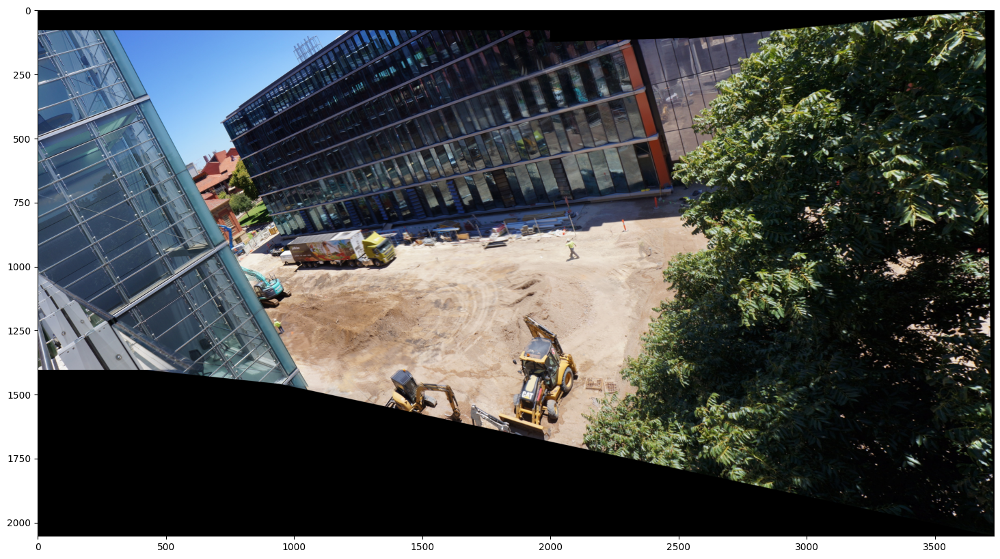

In [98]:
plot_image(blended234, figsize=(20,10))

In [99]:
h01 = np.linalg.inv(H_matrices[0])
h01 = h01/h01[-1,-1]
h01

array([[ 7.76494068e-01, -4.24884750e-02,  5.06202048e+02],
       [-2.33896092e-02,  9.26472110e-01, -4.42227451e+00],
       [-1.06891438e-04,  5.46378202e-06,  1.00000000e+00]])

In [100]:
# Canvas Size Calculation
H_inv01 = np.linalg.inv(h01)
corners = np.array([[0,0,1], [0,img.shape[0],1], [img.shape[1], img.shape[0],1], [img.shape[1], 0, 1]])
corners_ = np.dot(H_inv01, corners.T).T # translation_matrices[2] @
corners_ = corners_/corners_[:,2].reshape(-1,1)
corners_

canvas_shape = img.shape # blended_images[2]
canvas_corners = np.array([[0,0,1], [0,canvas_shape[0],1], [canvas_shape[1], canvas_shape[0],1], [canvas_shape[1], 0, 1]])
all_corners = np.concatenate([canvas_corners[:, :2], corners_[:, :2]], axis=0)
min_x = int(np.min(all_corners[:,0]))
max_x = int(np.max(all_corners[:,0]))
min_y = int(np.min(all_corners[:,1]))
max_y = int(np.max(all_corners[:,1]))

In [101]:
all_corners

array([[   0.        ,    0.        ],
       [   0.        , 1329.        ],
       [2000.        , 1329.        ],
       [2000.        ,    0.        ],
       [-652.54742033,  -11.7008969 ],
       [-568.51578273, 1524.01127478],
       [1575.73891703, 1247.19031547],
       [1510.77965513,   42.91421168]])

In [102]:
min_x, max_x, min_y, max_y

(-652, 2000, -11, 1524)

In [103]:
translation01 = np.array([[1, 0, -min_x], [0, 1, -min_y], [0, 0, 1]])
train_warped = cv2.warpPerspective(cv2.imread(all_images[0]), translation01 @ H_inv01, (max_x-min_x, max_y-min_y))

translation01 = translation01.astype(np.float32)
query_warped = cv2.warpPerspective(cv2.imread(all_images[1]), translation01, (max_x-min_x, max_y-min_y))


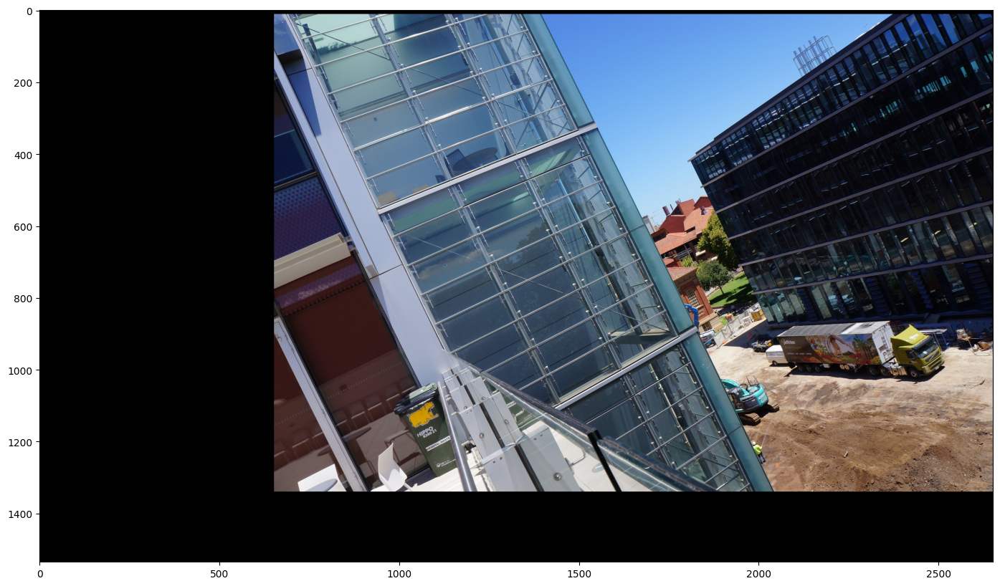

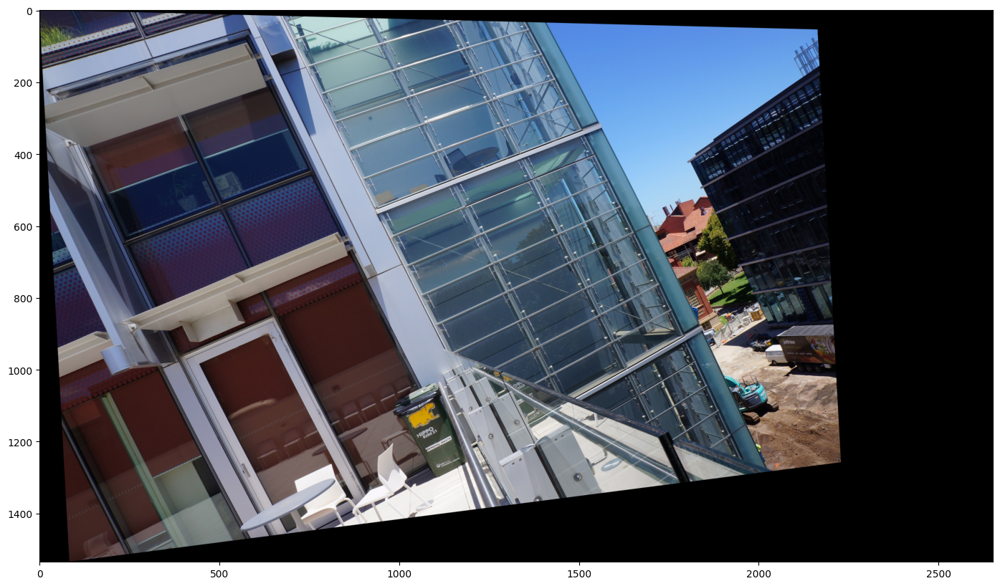

In [104]:
plot_image(query_warped, figsize=(20,10))
plot_image(train_warped, figsize=(20,10))

In [105]:
# Blending
mask = single_weights_matrix(img.shape[:2])

mask1 = cv2.warpPerspective(mask, translation01, (max_x-min_x, max_y-min_y))
mask2 = cv2.warpPerspective(mask,  translation01 @ H_inv01, (max_x-min_x, max_y-min_y))

mask1 = mask1/mask1.max()
mask2 = mask2/mask2.max()

normalized_mask = np.divide(mask1, mask1+mask2, where=(mask1+mask2)!=0)
normalized_mask = normalized_mask/normalized_mask.max()

normalized_mask = np.array([normalized_mask, normalized_mask, normalized_mask]).transpose(1,2,0)

blended01 = normalized_mask * query_warped + (1-normalized_mask) * train_warped
blended01 = blended01.astype(np.uint8)
weights01 = (mask1 + mask2)/(mask1 + mask2).max()

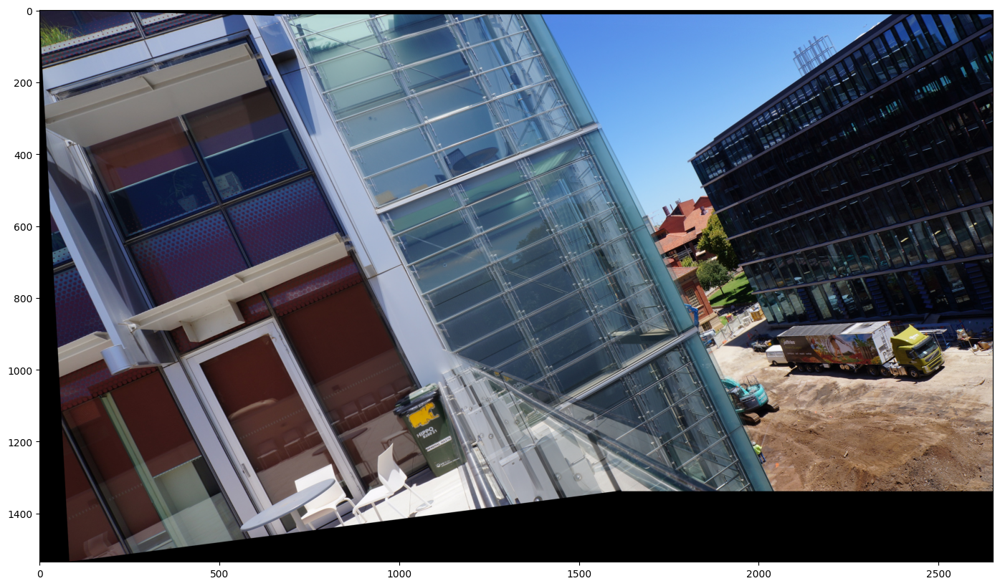

In [106]:
plot_image(blended01, figsize=(20,10))

In [107]:
h12 = np.linalg.inv(H_matrices[1])
h12 = h12/h12[-1,-1]
h12

array([[ 7.65479195e-01, -3.30923217e-02,  5.23974138e+02],
       [-4.32501615e-02,  9.11077960e-01,  7.63418163e+01],
       [-1.10997492e-04, -3.56973305e-06,  1.00000000e+00]])

In [108]:
# Canvas Size Calculation
H_inv12 = np.linalg.inv(h12)
corners = np.array([[0,0,1], [0,blended01.shape[0],1], [blended01.shape[1], blended01.shape[0],1], [blended01.shape[1], 0, 1]])
corners_ = np.dot(H_inv12 @ np.linalg.inv(translation01), corners.T).T # translation_matrices[2] @
corners_ = corners_/corners_[:,2].reshape(-1,1)
corners_

canvas_shape = blended234.shape # blended_images[2]
canvas_corners = np.array([[0,0,1], [0,canvas_shape[0],1], [canvas_shape[1], canvas_shape[0],1], [canvas_shape[1], 0, 1]])
canvas_corners_ = np.dot(np.linalg.inv(translation23), canvas_corners.T).T
all_corners = np.concatenate([canvas_corners_[:, :2], corners_[:, :2]], axis=0)
min_x = int(np.min(all_corners[:,0]))
max_x = int(np.max(all_corners[:,0]))
min_y = int(np.min(all_corners[:,1]))
max_y = int(np.max(all_corners[:,1]))

In [109]:
all_corners

array([[    0.        ,   -77.        ],
       [    0.        ,  1976.        ],
       [ 3730.        ,  1976.        ],
       [ 3730.        ,   -77.        ],
       [-1705.82037735,  -179.13792679],
       [-1604.68254695,  1799.96832665],
       [ 1530.73497603,  1369.22897109],
       [ 1494.14601664,   -22.93585207]])

In [110]:
min_x, max_x, min_y, max_y

(-1705, 3730, -179, 1976)

In [111]:
translation12 = np.array([[1, 0, -min_x], [0, 1, -min_y], [0, 0, 1]])
train_warped = cv2.warpPerspective(blended01, translation12 @ H_inv12 @ np.linalg.inv(translation01), (max_x-min_x, max_y-min_y))

translation12 = translation12.astype(np.float32)
query_warped = cv2.warpPerspective(blended234, translation12 @ np.linalg.inv(translation23), (max_x-min_x, max_y-min_y))


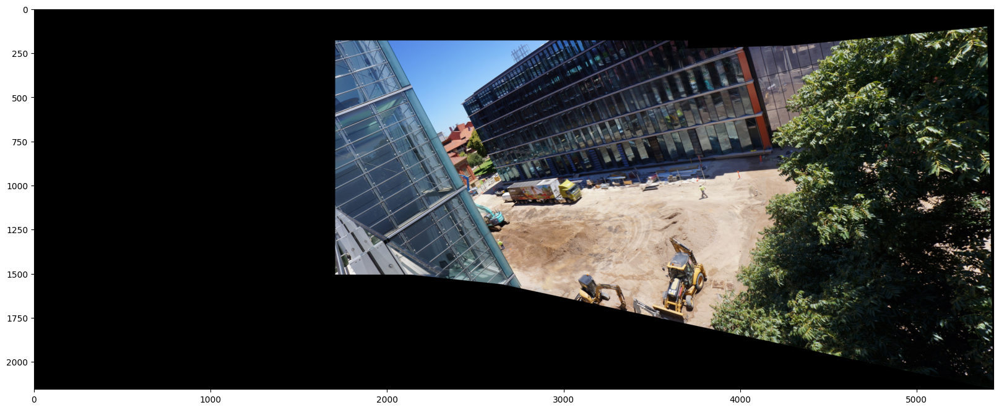

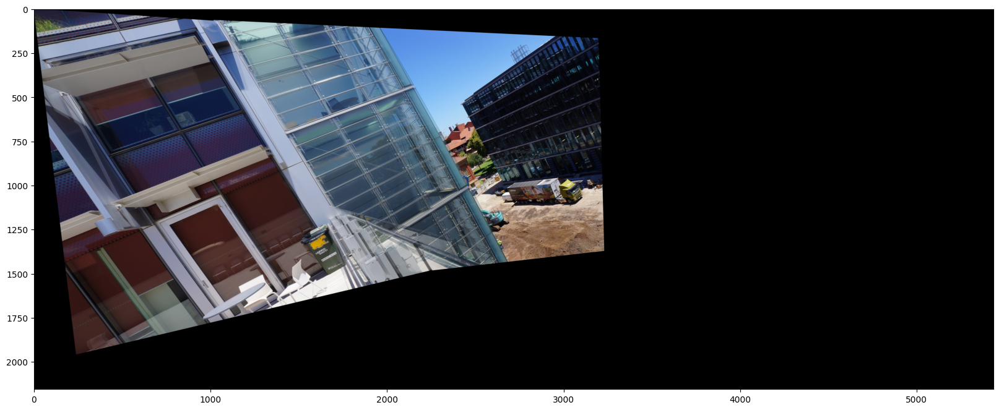

In [112]:
plot_image(query_warped, figsize=(20,10))
plot_image(train_warped, figsize=(20,10))

In [113]:
# Blending
# mask = single_weights_matrix(img.shape[:2])

mask1 = cv2.warpPerspective(weights234, translation12 @ np.linalg.inv(translation23), (max_x-min_x, max_y-min_y))
mask2 = cv2.warpPerspective(weights01, translation12 @ H_inv12 @ np.linalg.inv(translation01), (max_x-min_x, max_y-min_y))

mask1 = mask1/mask1.max()
mask2 = mask2/mask2.max()

normalized_mask = np.divide(mask1, mask1+mask2, where=(mask1+mask2)!=0)
normalized_mask = normalized_mask/normalized_mask.max()

normalized_mask = np.array([normalized_mask, normalized_mask, normalized_mask]).transpose(1,2,0)

final_blended = normalized_mask * query_warped + (1-normalized_mask) * train_warped
final_blended = final_blended.astype(np.uint8)
final_weights = (mask1 + mask2)/(mask1 + mask2).max()

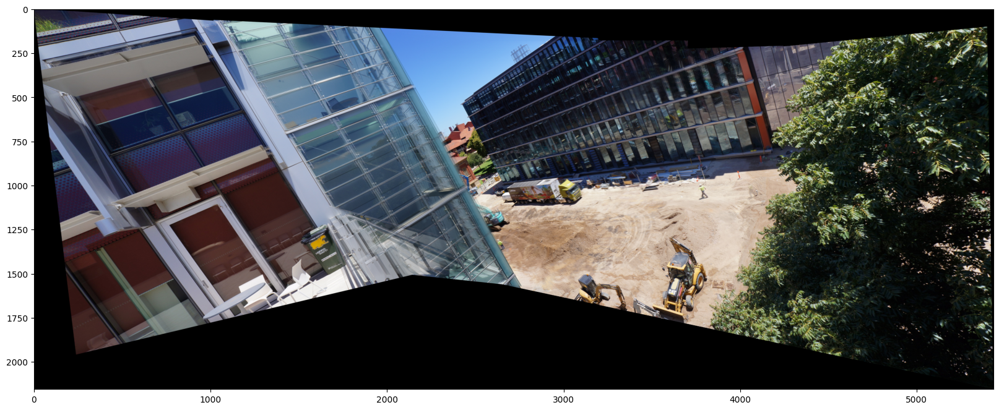

In [114]:
plot_image( final_blended, figsize=(20,10))

# GOD-FUNCTION

In [ ]:
# Given the homography matrices,images and reference image index, this function returns the final stitched image